*Compiled on Feb 13, 2019 with scanpy v.1.4   

# Human lung

Scanpy allows to reproduce most of Seurat's ([Satija *et al.*, 2015](https://doi.org/10.1038/nbt.3192)) standard clustering tutorial as described on http://satijalab.org/seurat/pbmc3k_tutorial.html (July 26, 2017). We gratefully acknowledge  the Seurat authors for publishing the tutorial!


In [12]:
import numpy as np
import pandas as pd
import scanpy.api as sc
import anndata
import bbknn
#import scrublet as scr
import bbknn
from collections import Counter
import os

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=80, color_map='viridis')
sc.logging.print_versions()
results_file = 'lung.h5ad'
path = '/home/jovyan/tisstab/data/' #Input your directory with files
os.chdir(path)

scanpy==1.4 anndata==0.6.18 numpy==1.16.1 scipy==1.2.1 pandas==0.24.1 scikit-learn==0.20.2 statsmodels==0.9.0 python-igraph==0.7.1 louvain==0.6.1 


In [13]:
#%load_ext autoreload
#%autoreload 2

def update_label(from_adata,from_label,to_adata,old_label,new_label,exclude=None,include=None,replace=False):
    if new_label in to_adata.obs.columns:
        if replace==False:
            raise SystemError
        if replace==True:
            i =  1
            while True:
                new_key = new_label+'.replaced.'+str(i)
                if new_key in to_adata.obs.columns:
                    continue
                else:
                    to_adata.obs[new_key] = list(to_adata.obs[new_label])
                    break
    if exclude:
        ON = {O:N for O,N in zip(from_adata.obs_names,from_adata.obs[from_label]) if N not in exclude}
    elif include:
        ON = {O:N for O,N in zip(from_adata.obs_names,from_adata.obs[from_label]) if N in include}
    else:
        ON = {O:N for O,N in zip(from_adata.obs_names,from_adata.obs[from_label])}
    to_adata.obs[new_label] = [ON[O] if O in ON else N for O,N in zip(to_adata.obs_names,to_adata.obs[old_label])]
    
    

def calculate_markers(adata,group_key,exclude = None, cnt_cut=3, tot_cnt_cut=10):

    # group_key = 'louvain'

    ctlist = np.array(sorted(list(set(adata.obs[group_key]))))
    
    if exclude:
        ctlist = [x for x in ctlist if x not in exclude]
    
    mtx = adata.raw
    len_gene = mtx.X.shape[1]

    mean_dt = {}
    cnt_dt = {}
    drop_dt = {}

    for ct in ctlist:
        ct_cond = adata.obs[group_key]==ct
        if np.sum(ct_cond)<tot_cnt_cut:
            continue
        print(ct)
        len_ct = np.sum(ct_cond)
        mtx_ct = mtx[ct_cond].X
        pos_count = Counter(mtx_ct.nonzero()[1])
        cnt_arr = np.zeros(len_gene)
        for pos in pos_count:
            cnt_arr[pos] = pos_count[pos]
        cnt_dt[ct] = cnt_arr
        cnt_mask = (cnt_arr<cnt_cut)
        drop_dt[ct] = cnt_arr/len_ct
        mean_arr = np.mean(mtx_ct,axis=0).A1
        mean_arr[cnt_mask] = 0
        mean_dt[ct] = mean_arr
    
    cdm_out = {"cnt":cnt_dt, "drop":drop_dt, "mean":mean_dt}
    return cdm_out

def draw_marker_blob(adata,cdm_out,genes,ctlist = None,fontsize=10, figscale=0.25,save=None, show=True, min_drop_ratio=0.01):

    cnt_dt = cdm_out["cnt"]
    drop_dt = cdm_out["drop"]
    mean_dt = cdm_out["mean"]
    
    if ctlist == None:
        ctlist = np.array(sorted(list(drop_dt.keys())))

    xpos = []
    ypos = []
    yticks = []
    yticklabels = []

    x1 = []
    y1 = []

    yidx = 0
    
    for gene in genes[::-1]:

        if gene in adata.raw.var_names:
            yidx += 1
            k = np.where(adata.raw.var_names == gene)[0][0]

            x1.extend([drop_dt[ct][k] if drop_dt[ct][k] > min_drop_ratio else 0 for ct in ctlist])
            y0 = np.array([mean_dt[ct][k] for ct in ctlist])
            y1.extend(list(y0/np.max(y0)))
            
            yticks.append(yidx)
            yticklabels.append(gene)
            
        else:

            yidx += 0.5
            x1.extend([0]*len(ctlist))
            y1.extend([0]*len(ctlist))
                                   
        xpos.extend(list(range(len(ctlist))))
        ypos.extend([yidx]*len(ctlist))

    x1 = np.array(x1)
    y1 = np.array(y1)
    
    fig = plt.figure(figsize=(len(ctlist)*figscale,len(genes)*figscale*0.9))
    ax = fig.add_subplot(1,1,1)
    sc = ax.scatter(xpos,ypos,s=x1*figscale*400,c=y1,cmap='OrRd')
    ax.set_yticks(yticks)
    ax.set_yticklabels(yticklabels,fontsize=fontsize)
    ax.set_xticks(range(len(ctlist)))
    ax.set_xticklabels(ctlist,rotation=90,fontsize=fontsize)
    ax.set_ylim(min(ypos)-0.5,max(ypos)+0.5)
    ax.set_xlim(min(xpos)-0.5,max(xpos)+0.5)
    plt.grid(False)
    
    from mpl_toolkits.axes_grid1 import make_axes_locatable
    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="5%", pad=0.05)
    cbar = plt.colorbar(sc,cax=cax)
    cbar.ax.tick_params(labelsize=8) 
    
    if save:
        plt.savefig(save,format='pdf')
    if show:
        plt.show()
    

In [35]:
metadata = pd.read_csv('allsamples.csv', sep = ',', index_col = 0)

metadata = metadata.loc[metadata['organ'] == 'Lung']

metadata['Donor']= metadata['patient']
metadata['Time']=metadata['timepoint']
metadata['donor_time']=metadata['Donor'] + '_' + metadata['Time']
metadata['time_donor']=metadata['Time'] + '_' + metadata['Donor']

metadata.head()

,organ,patient,timepoint,Donor,Time,donor_time,time_donor
sample,,,,,,,
HCATisStab7509734,Lung,343B,0h,343B,0h,343B_0h,0h_343B
HCATisStab7509735,Lung,343B,24h,343B,24h,343B_24h,24h_343B
HCATisStab7509736,Lung,343B,72h,343B,72h,343B_72h,72h_343B
HCATisStab7587202,Lung,356C,0h,356C,0h,356C_0h,0h_356C
HCATisStab7587205,Lung,356C,12h,356C,12h,356C_12h,12h_356C


In [566]:

filenames = metadata.index
adatas = [sc.read_10x_mtx(path + filename + '/filtered_gene_bc_matrices/GRCh38/') for filename in filenames]
for i in range(len(adatas)):
    adatas[i].obs['sample'] = metadata.index[i]
    for col in metadata.columns:
        adatas[i].obs[col] = metadata[col][i]
adata = adatas[0].concatenate(adatas[1:], batch_categories = metadata.index)
adata

--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading fr

AnnData object with n_obs × n_vars = 79111 × 33694 
    obs: 'Donor', 'Time', 'batch', 'donor_time', 'organ', 'patient', 'sample', 'time_donor', 'timepoint'
    var: 'gene_ids-HCATisStab7509734', 'gene_ids-HCATisStab7509735', 'gene_ids-HCATisStab7509736', 'gene_ids-HCATisStab7587202', 'gene_ids-HCATisStab7587205', 'gene_ids-HCATisStab7587208', 'gene_ids-HCATisStab7587211', 'gene_ids-HCATisStab7646032', 'gene_ids-HCATisStab7646033', 'gene_ids-HCATisStab7646034', 'gene_ids-HCATisStab7646035', 'gene_ids-HCATisStab7659968', 'gene_ids-HCATisStab7659969', 'gene_ids-HCATisStab7659970', 'gene_ids-HCATisStab7659971', 'gene_ids-HCATisStab7747197', 'gene_ids-HCATisStab7747198', 'gene_ids-HCATisStab7747199', 'gene_ids-HCATisStab7747200'

In [ ]:
adata.write('lung.h5ad')


In [41]:
#adata = sc.read('lung.h5ad')

In [567]:
adata

AnnData object with n_obs × n_vars = 79111 × 33694 
    obs: 'Donor', 'Time', 'batch', 'donor_time', 'organ', 'patient', 'sample', 'time_donor', 'timepoint'
    var: 'gene_ids-HCATisStab7509734', 'gene_ids-HCATisStab7509735', 'gene_ids-HCATisStab7509736', 'gene_ids-HCATisStab7587202', 'gene_ids-HCATisStab7587205', 'gene_ids-HCATisStab7587208', 'gene_ids-HCATisStab7587211', 'gene_ids-HCATisStab7646032', 'gene_ids-HCATisStab7646033', 'gene_ids-HCATisStab7646034', 'gene_ids-HCATisStab7646035', 'gene_ids-HCATisStab7659968', 'gene_ids-HCATisStab7659969', 'gene_ids-HCATisStab7659970', 'gene_ids-HCATisStab7659971', 'gene_ids-HCATisStab7747197', 'gene_ids-HCATisStab7747198', 'gene_ids-HCATisStab7747199', 'gene_ids-HCATisStab7747200'

## Preprocessing

Basic filtering.

In [568]:
sc.pp.filter_cells(adata, min_genes=300)
sc.pp.filter_genes(adata, min_cells=3)

filtered out 13552 cells that have less than 300 genes expressed
filtered out 8490 genes that are detected in less than 3 cells


Plot some information about mitochondrial genes, important for quality control. Note that you can also retrieve mitochondrial genes using `sc.queries.mitochondrial_genes_biomart('www.ensembl.org', 'mmusculus')`.

In [569]:
mito_genes = [name for name in adata.var_names if name.startswith('MT-')]
# for each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary, as X is sparse - it transform to a dense array after summing
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1


A violin plot of the computed quality measures.

In [3]:
%pylab inline
pylab.rcParams['figure.figsize'] = (12, 6)

Populating the interactive namespace from numpy and matplotlib


In [75]:
#sc.pl.violin(adata, ['n_genes'],
#            jitter=0.4, groupby='donor_time', rotation=90)
#sc.pl.violin(adata, ['n_counts'],
#            jitter=0.4, groupby='donor_time', rotation=90)
#sc.pl.violin(adata, ['percent_mito'],
#            jitter=0.4, groupby='donor_time', rotation=90)

Actually do the filtering.

In [570]:
adata = adata[adata.obs['n_genes'] < 5000, :]
adata = adata[adata.obs['n_counts'] < 20000, :]

In [572]:
highmito = adata[adata.obs['percent_mito'] >= 0.1, :]
highmito.write('lung.raw.h5ad')

... storing 'Time' as categorical
... storing 'donor_time' as categorical
... storing 'organ' as categorical
... storing 'patient' as categorical
... storing 'sample' as categorical
... storing 'time_donor' as categorical
... storing 'timepoint' as categorical


In [ ]:

adata.obs.to_csv("lung_meta_raw.csv")

In [ ]:
adata = adata[adata.obs['percent_mito'] < 0.1, :]

Set the `.raw` attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. This simply freezes the state of the AnnData object returned by `sc.pp.log1p`.

In [744]:
adata.raw = sc.pp.log1p(adata, copy=True)

Per-cell normalize the data matrix $\mathbf{X}$. Many people would consider the normalized data matrix as the "relevant data" for visualization and differential testing (assessing feature importance).

In [745]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)

Identify highly-variable genes.

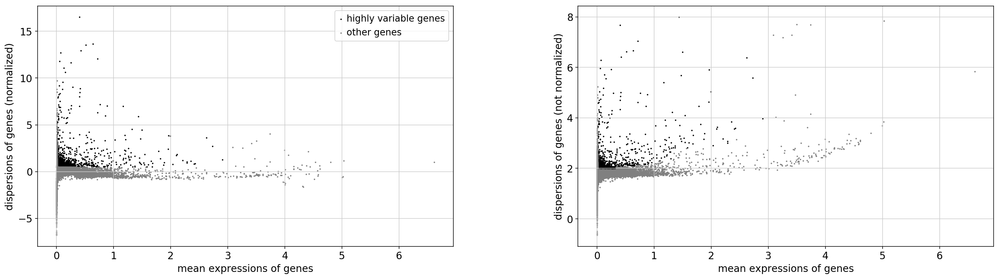

In [746]:
filter_result = sc.pp.filter_genes_dispersion(
    adata.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
sc.pl.filter_genes_dispersion(filter_result)

In [747]:
adata

AnnData object with n_obs × n_vars = 94257 × 22612 
    obs: 'Donor', 'Time', 'batch', 'donor_time', 'organ', 'patient', 'sample', 'time_donor', 'timepoint', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids-HCATisStab7463846', 'gene_ids-HCATisStab7463847', 'gene_ids-HCATisStab7463848', 'gene_ids-HCATisStab7463849', 'gene_ids-HCATisStab7587200', 'gene_ids-HCATisStab7587203', 'gene_ids-HCATisStab7587206', 'gene_ids-HCATisStab7587209', 'gene_ids-HCATisStabAug177078016', 'gene_ids-HCATisStabAug177078017', 'gene_ids-HCATisStabAug177078018', 'gene_ids-HCATisStabAug177078019', 'gene_ids-HCATisStabAug177276391', 'gene_ids-HCATisStabAug177276392', 'gene_ids-HCATisStabAug177276394', 'gene_ids-HCATisStabAug177376561', 'gene_ids-HCATisStabAug177376563', 'gene_ids-HCATisStabAug177376565', 'gene_ids-HCATisStabAug177376567', 'n_cells'

In [748]:
fulldata=adata
fulldata.write('lung.full.h5ad')

In [749]:
adata = adata[:, filter_result.gene_subset]

In [30]:
adata

AnnData object with n_obs × n_vars = 57020 × 2740 
    obs: 'Donor', 'Time', 'batch', 'donor_time', 'organ', 'patient', 'sample', 'time_donor', 'timepoint', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids-HCATisStab7509734', 'gene_ids-HCATisStab7509735', 'gene_ids-HCATisStab7509736', 'gene_ids-HCATisStab7587202', 'gene_ids-HCATisStab7587205', 'gene_ids-HCATisStab7587208', 'gene_ids-HCATisStab7587211', 'gene_ids-HCATisStab7646032', 'gene_ids-HCATisStab7646033', 'gene_ids-HCATisStab7646034', 'gene_ids-HCATisStab7646035', 'gene_ids-HCATisStab7659968', 'gene_ids-HCATisStab7659969', 'gene_ids-HCATisStab7659970', 'gene_ids-HCATisStab7659971', 'gene_ids-HCATisStab7747197', 'gene_ids-HCATisStab7747198', 'gene_ids-HCATisStab7747199', 'gene_ids-HCATisStab7747200', 'n_cells'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

Logarithmize the data.

In [751]:
sc.pp.log1p(adata)

Regress out effects of total counts per cell and the percentage of mitochondrial genes expressed. Scale the data to unit variance.

In [752]:
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])

regressing out ['n_counts']
    sparse input is densified and may lead to high memory use
    finished (0:02:52.43)


In [754]:
sc.pp.regress_out(adata, ['Donor'])

regressing out ['Donor']
    finished (0:02:47.90)


In [755]:
sc.pp.scale(adata, max_value=10)

Save the result.

In [756]:
#adata.write('lung.h5ad')

## PCA

Compute PCA and make a scatter plot.

In [28]:
#adata=sc.read('lung.h5ad')

In [64]:
sc.tl.pca(adata)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.


In [65]:
adata.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat

In [46]:
#adata.write('lung.h5ad')

In [61]:
#adata = sc.read('lung.h5ad')

In [66]:
adata

AnnData object with n_obs × n_vars = 57020 × 2740 
    obs: 'Donor', 'Time', 'batch', 'donor_time', 'organ', 'patient', 'sample', 'time_donor', 'timepoint', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids-HCATisStab7509734', 'gene_ids-HCATisStab7509735', 'gene_ids-HCATisStab7509736', 'gene_ids-HCATisStab7587202', 'gene_ids-HCATisStab7587205', 'gene_ids-HCATisStab7587208', 'gene_ids-HCATisStab7587211', 'gene_ids-HCATisStab7646032', 'gene_ids-HCATisStab7646033', 'gene_ids-HCATisStab7646034', 'gene_ids-HCATisStab7646035', 'gene_ids-HCATisStab7659968', 'gene_ids-HCATisStab7659969', 'gene_ids-HCATisStab7659970', 'gene_ids-HCATisStab7659971', 'gene_ids-HCATisStab7747197', 'gene_ids-HCATisStab7747198', 'gene_ids-HCATisStab7747199', 'gene_ids-HCATisStab7747200', 'n_cells'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

## BBKNN correction and UMAP plot

In [67]:
bbknn.bbknn(adata, batch_key='patient',neighbors_within_batch = 4)
sc.tl.umap(adata)

computing batch balanced neighbors
    finished (0:00:21.31) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:02:29.56) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [271]:
sc.tl.leiden(adata, resolution=1.2)


running Leiden clustering
    finished (0:02:24.47) --> found 22 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


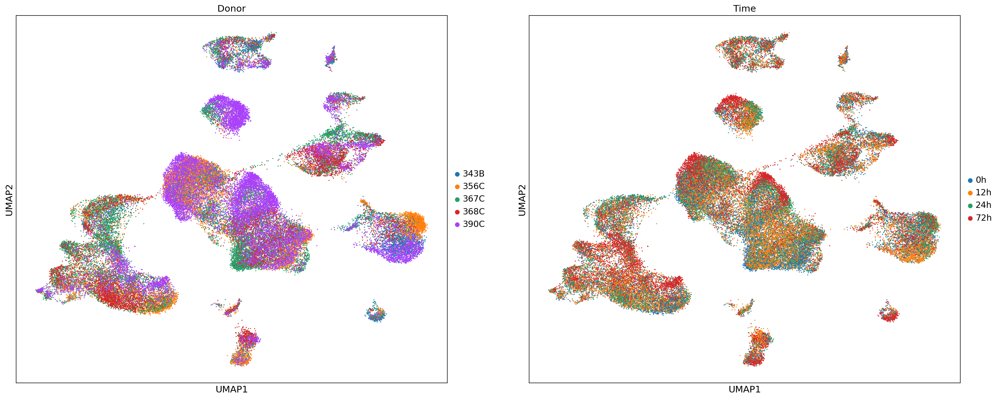

In [272]:
pylab.rcParams['figure.figsize'] = (12, 10)

sc.pl.umap(adata,color=['Donor','Time'], size=10)

In [ ]:
#adata.write('lung.h5ad')
adata=sc.read('lung.h5ad')

In [ ]:
marker_genes_all = ['PTPRC',#immune
                       
                  'LYZ', #monocyte/macrophage
                  'CD14', 'VCAN', 'FCN1', #Monocyte
                  'APOE', 'CD5L', #Macrophage
                       'MARCO', 'HLA-DRA', #Macrophage type 1 and 2 (type 2 is CD1C- and MARCO-)
                  'IL3RA', 'CLEC4C', #plasmacytoid DC
                'CLEC9A', 'XCR1', #cDC1
                  'CD1C',  'CLEC10A', #cDC2
                  'GP9', 'PF4', 'PPBP',#platelets
                
                  'CD19', 'CD79A', 'MS4A1', #B-cell
                  'CR2', 'CD27',  'TNFRSF13B', #Mantle B cells
                  'IGHD', 'FCER2', 'TCL1A', 'YBX3', 'IL4R', #Follicular B cells
                  'SDC1', 'XBP1', 'JCHAIN', #Plasma cells
                
                  'MKI67','CDK1', #Dividing
                
                  'CD3E','CD4', 'CD8A', #T-cells CD4 or CD8
                        'GZMB', 'GNLY', 'PRF1',#Cytotoxic T CTL
                'FCGR3A', 'TRGV2' ,#gamma delta T-cells
                        'SLC4A10',  'KLRB1' ,#MAIT cells
                       'LEF1', 'CCR7', #Naive
                        'FOXP3', 'IL2RA', #Treg
                       'CXCR5', 'ICOS', 'PDCD1',  #Tfh 
                  'IL7R', 'KLRB1', 'AREG', 'TNFSF13B', #ILC
                  'NCR1', 'NCAM1', 'CD160', 'FCGR3A', #NK, FCGR3A allergic response
                       'TPSB2', #Mast cell
                       'AGER', 'SFTPC', 'SLPI','EPCAM', #Type 1 (AGER) and 2 alveolar cells
                       'PECAM1', #Endothelial
                       'VWF', 'CCL21', #vascular vs lymphatic
                       'PDGFRA', 'VCAN', #Fibroblast
                       'ACTA2', 'TAGLN', #Muscle cells
                       'FOXI1', 'CFTR', #Ionocytes
                       'EPCAM','PIFO', 'FOXJ1' ,#ciliated
                       'MUC5AC', 'MUC5B', 'SCGB1A1' #Secretory
                      ]


In [ ]:
adata

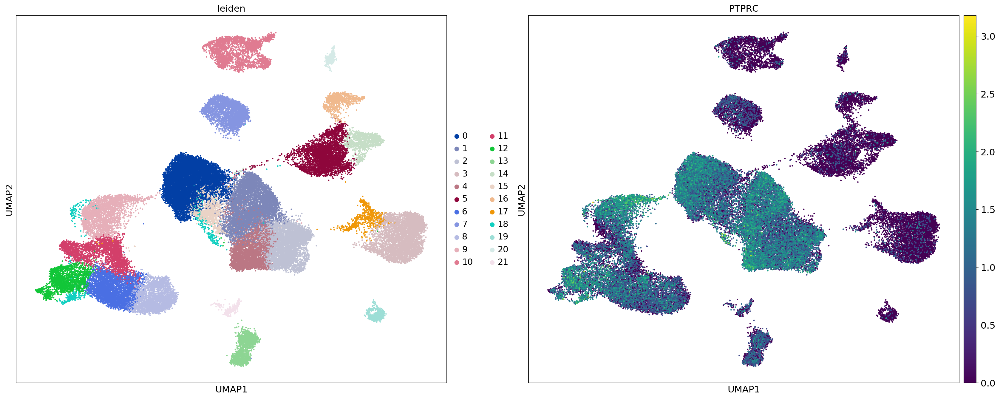

In [366]:
sc.pl.umap(adata,color=['leiden', #clusters
                  'PTPRC',#immune
                       ], size=20)

In [76]:
#sc.pl.umap(adata,color=['CD19', #B-cells
#                        'TPSB2', #Mast cell
#                        'JCHAIN', #Plasma cell
#                        'MKI67', 'CDK1', #Dividing cells
#                        'AGER', 'SFTPC', 'SLPI','EPCAM', #Type 1 (AGER) and 2 alveolar cells
 #                      'PECAM1', #Endothelial
#                       'VWF', 'CCL21', #vascular vs lymphatic
#                       'PDGFRA', 'VCAN', #Fibroblast
#                       'ACTA2', 'TAGLN', #Muscle cells
#                       'FOXI1', 'CFTR', #Ionocytes
#                       'EPCAM','PIFO', 'FOXJ1' ,#ciliated
#                       'MUC5AC', 'MUC5B', 'SCGB1A1' #Secretory
#                       ], size=20)

Clusters are renamed based on known markers

In [47]:
new_cluster_names = [
    'Lymphocytes', 'Lymphocytes', #0,1
    'Lymphocytes', 'Alveolar_Type2', #2, 3
    'Lymphocytes', 'Fibroblast',#4, 5
    'Mononuclear', 'Mast_cells', #6, 7
    'Mononuclear', 'Mononuclear', #8,9
    'Blood_vessel', 'Mononuclear', #10, 11
    'Mononuclear', 'B_cells',#12,13
    'Fibroblast', 'Lymphocytes', #14, 15
    'Muscle_cells', 'Alveolar_Type1', #16, 17
    'Dividing', 'Ciliated',#18,19
    'Lymph_vessel', 'Plasma_cells' #20, 21
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['Celltype'] = [conv[x] for x in adata.obs['leiden']]

In [48]:
adata.obs.Celltype.value_counts()

Lymphocytes       23865
Mononuclear       13427
Alveolar_Type2     4676
Fibroblast         4624
Mast_cells         2911
Blood_vessel       2694
B_cells            1551
Muscle_cells        839
Alveolar_Type1      764
Dividing            554
Ciliated            466
Lymph_vessel        337
Plasma_cells        312
Name: Celltype, dtype: int64

... storing 'Celltype' as categorical


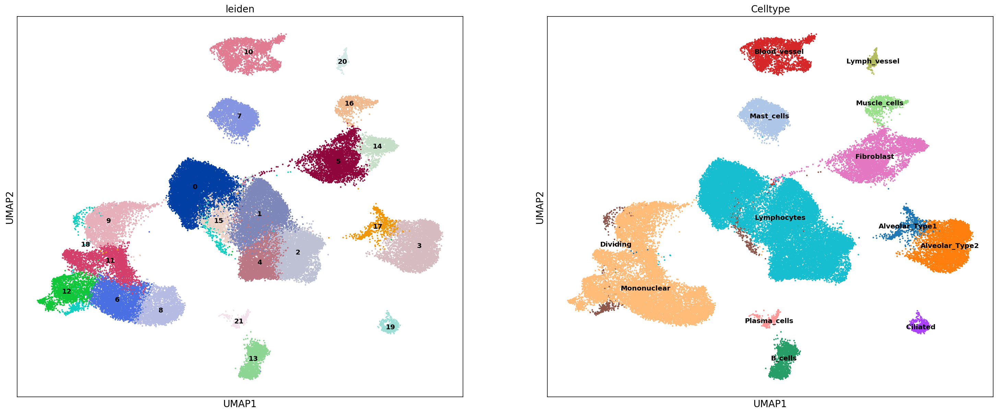

In [36]:
sc.pl.umap(adata,color=['leiden', #clusters
                  'Celltype',#immune
                       ], legend_loc='on data',size=20)

In [32]:
#adata.write('lung.h5ad')
adata=sc.read('lung.h5ad')

## Subsetting and finer annotation of plasma and mononuclear immune cells

In [483]:
#adata = sc.read('lung.h5ad')
#fulldata=sc.read('lung.full.h5ad')
#tiss=sc.read('lung_imm.h5ad')

In [508]:
tiss=fulldata[[i in ['Mononuclear', 'Plasma_cells'] for i in adata.obs['Celltype']]]
#Plasma cells seem to be a heterogeneous population

tiss.raw = sc.pp.log1p(tiss, copy=True)
sc.pp.normalize_per_cell(tiss, counts_per_cell_after=1e4)
filter_result = sc.pp.filter_genes_dispersion(
    tiss.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pl.filter_genes_dispersion(filter_result)
tiss = tiss[:, filter_result.gene_subset]
sc.pp.log1p(tiss)
sc.pp.regress_out(tiss, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:00:54.33)


In [509]:
sc.pp.regress_out(tiss, ['Donor'])

regressing out ['Donor']
    finished (0:00:51.26)


In [510]:
sc.pp.scale(tiss, max_value=10)
sc.tl.pca(tiss)
tiss.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
bbknn.bbknn(tiss, batch_key='patient',neighbors_within_batch = 4)
sc.tl.umap(tiss)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing batch balanced neighbors
    finished (0:00:03.86) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:21.32) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [511]:
sc.tl.leiden(tiss,resolution=1.2)

running Leiden clustering
    finished (0:00:24.15) --> found 15 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


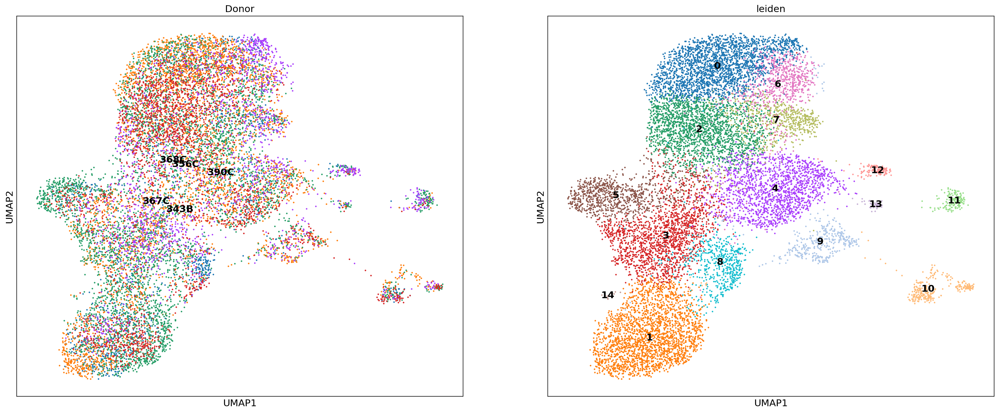

In [512]:
sc.pl.umap(tiss,color=['Donor','leiden'], legend_loc='on data', size=20)

In [4]:
#tiss.write('lung_imm.h5ad')
tiss=sc.read('lung_imm.h5ad')

In [519]:
marker_genes_all = ['VCAN', 'FCN1', #Monocyte
                  'APOE', 'CD5L', #Macrophage
                       'MARCO',#Macrophage type 1 and 2 (type 2 is CD1C- and MARCO-)
                  'IL3RA', 'CLEC4C', #plasmacytoid DC
                'CLEC9A', 'XCR1', #cDC1
                  'CD1C',  'CLEC10A', #cDC2
                       'CCR7' #activated DC
                
                  'SDC1', 'XBP1', 'JCHAIN', #Plasma cells
                'MKI67','CDK1', #Dividing
                    
                  'CD3E','CD4', 'CD8A', #T-cells CD4, CD8
                       'SLPI', 'SFTPC' #Type 1 alveolar cells
                      ]

In [ ]:
#sc.pl.umap(tiss,color=['VCAN', 'FCN1', #Monocyte
#                  'APOE',#Macrophage
#                       'MARCO',#Macrophage type 1 and 2 (type 2 is CD1C- and MARCO-)
#                  'IL3RA', 'CLEC4C', #plasmacytoid DC
#                'CLEC9A', 'XCR1', #cDC1
#                  'CD1C',  'CLEC10A', #cDC2
 #                      'CCR7' #activated DC
#                      ], size=20)

 

In [ ]:
#sc.pl.umap(tiss,color=['SDC1', 'XBP1', 'JCHAIN', #Plasma cells
#                        'IGHM', 'IGHG1', #Plasma cells
#                'MKI67',#Dividing
#                       'CD3E' #T-cells CD4, CD8
#                      ], size=20)

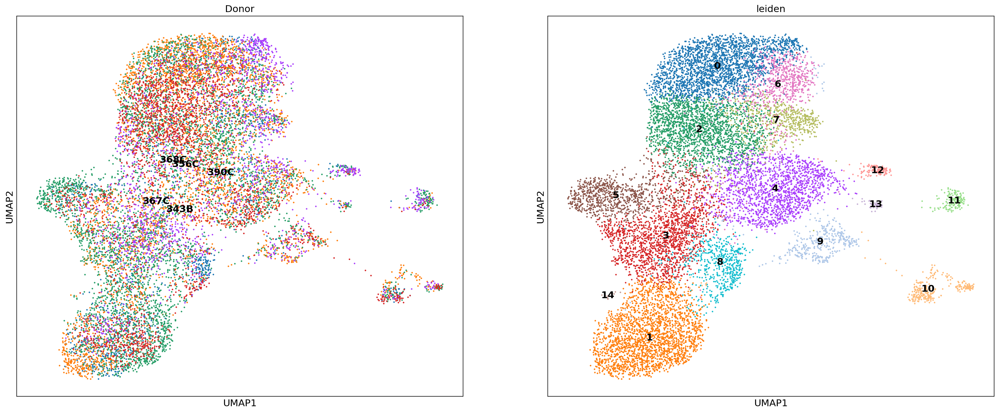

In [518]:
sc.pl.umap(tiss,color=['Donor','leiden'], legend_loc='on data', size=20)

In [5]:
new_cluster_names = [
    'Monocyte', 'Macrophage_MARCOpos', #0,1
    'Monocyte', 'Macrophage_MARCOpos', #2, 3
    'DC_2', 'Macrophage_MARCOneg',#4, 5
    'Monocyte', 'Monocyte', #6, 7
    'Macrophage_MARCOpos', 'Monocyte', #8,9
    'Plasma_cells', 'DC_1', #10, 11
    'DC_activated', 'DC_plasmacytoid',#12,13
    'Macrophage_MARCOpos'#14
]

In [6]:
conv = {str(i):name for i,name in enumerate(new_cluster_names)}

In [7]:
tiss.obs['anno_1'] = [conv[x] for x in tiss.obs['leiden']]

In [8]:
cdm_out = calculate_markers(tiss,'leiden')

0
1
10
11
12
13
14
2
3
4
5
6
7
8
9


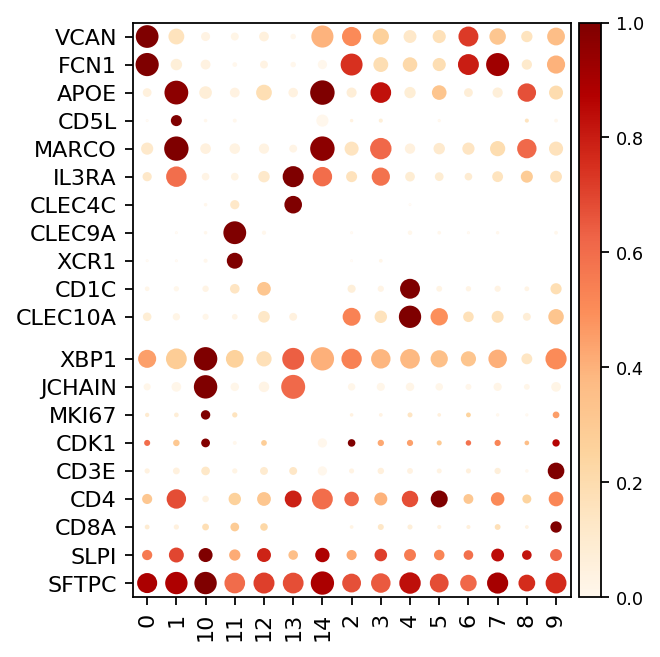

In [530]:
draw_marker_blob(tiss, cdm_out, marker_genes_all, min_drop_ratio=0)

... storing 'anno_1' as categorical


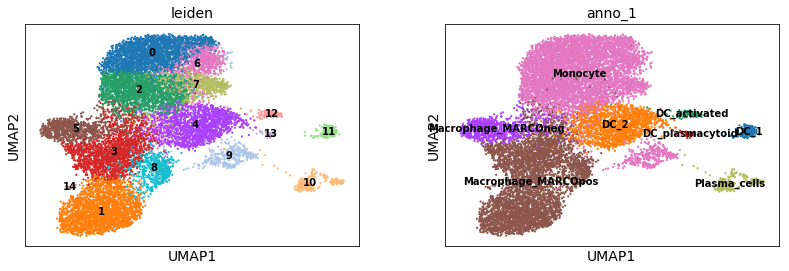

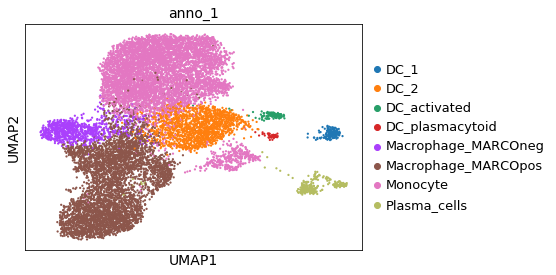

In [9]:
sc.pl.umap(tiss,color=['leiden','anno_1'], legend_loc='on data',
           size=20)
sc.pl.umap(tiss,color=['anno_1'], 
           size=20)


In [10]:
tiss.write('lung_imm.h5ad')

## Subsetting and finer annotation of dividing cells

In [11]:
#tiss=sc.read('lung_div.h5ad')

In [446]:
tiss=fulldata[[i in ['Dividing'
                    ] for i in adata.obs['Celltype']]]
#Plasma cells seem to be a heterogeneous population

tiss.raw = sc.pp.log1p(tiss, copy=True)
sc.pp.normalize_per_cell(tiss, counts_per_cell_after=1e4)
filter_result = sc.pp.filter_genes_dispersion(
    tiss.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pl.filter_genes_dispersion(filter_result)
tiss = tiss[:, filter_result.gene_subset]
sc.pp.log1p(tiss)
sc.pp.regress_out(tiss, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:00:15.61)


In [447]:
sc.pp.regress_out(tiss, ['Donor'])

regressing out ['Donor']
    finished (0:00:12.96)


In [448]:
sc.pp.scale(tiss, max_value=10)
sc.tl.pca(tiss)
tiss.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
bbknn.bbknn(tiss, batch_key='patient',neighbors_within_batch = 4)
sc.tl.umap(tiss)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing batch balanced neighbors
    finished (0:00:00.18) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:01.42) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [449]:
sc.tl.leiden(tiss,resolution=0.9)

running Leiden clustering
    finished (0:00:00.10) --> found 8 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


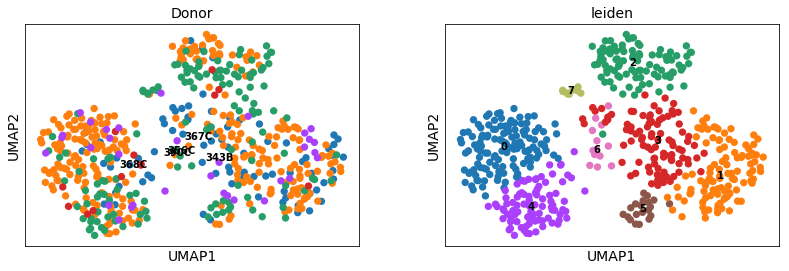

In [12]:
sc.pl.umap(tiss,color=['Donor','leiden'], legend_loc='on data')

In [71]:
marker_genes = ['CD3E','CD4', 'CD8A', #T-cells CD4, CD8, NK
                    'NCR1', 'NCAM1', 'CD160', #NK
                       'CD1C',#DC
                       'MARCO','APOE', #Macrophage
                       'VCAN', 'FCN1', #Monocyte
                     ]
#sc.pl.umap(tiss,color=marker_genes)

In [13]:
new_cluster_names = [
    'NK_Dividing', 'DC_Monocyte_Dividing', #0,1
    'Macrophage_Dividing', 'DC_Monocyte_Dividing', #2, 3
    'T_cells_Dividing', 'DC_Monocyte_Dividing',#4, 5
    'DC_Monocyte_Dividing','DC_Monocyte_Dividing' #6, 7
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

tiss.obs['anno_1'] = [conv[x] for x in tiss.obs['leiden']]





In [14]:
cdm_out = calculate_markers(tiss,'leiden')


0
1
2
3
4
5
6
7


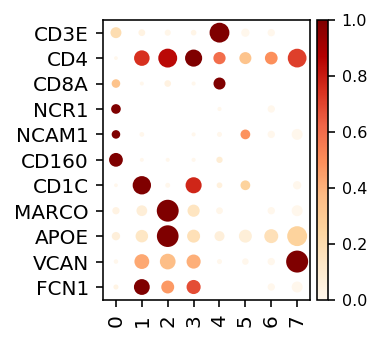

In [37]:

draw_marker_blob(tiss, cdm_out, marker_genes, min_drop_ratio=0)

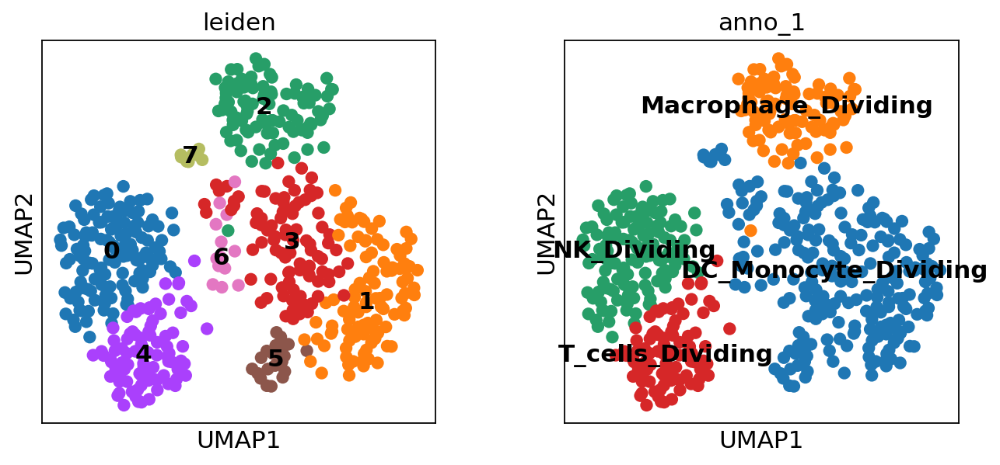

In [21]:
sc.pl.umap(tiss,color=['leiden', 'anno_1'] ,legend_loc='on data'
          )

In [22]:
tiss.write('lung_div.h5ad')

## Subsetting and finer annotation of lymphocytes

In [420]:
#tiss=sc.read('lung_lympho.h5ad')

In [294]:
tiss=fulldata[[i in ['Lymphocytes', 
    #'Dividing', 'Mononuclear', 'Plasma_cells'
                    ] for i in adata.obs['Celltype']]]
#Plasma cells seem to be a heterogeneous population

tiss.raw = sc.pp.log1p(tiss, copy=True)
sc.pp.normalize_per_cell(tiss, counts_per_cell_after=1e4)
filter_result = sc.pp.filter_genes_dispersion(
    tiss.X, min_mean=0.0125, max_mean=3, min_disp=0.5)
#sc.pl.filter_genes_dispersion(filter_result)
tiss = tiss[:, filter_result.gene_subset]
sc.pp.log1p(tiss)
sc.pp.regress_out(tiss, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:00:45.01)


In [295]:
sc.pp.regress_out(tiss, ['Donor'])

regressing out ['Donor']
    finished (0:00:40.99)


In [296]:
sc.pp.scale(tiss, max_value=10)
sc.tl.pca(tiss)
tiss.obsm['X_pca'] *= -1  # multiply by -1 to match Seurat
bbknn.bbknn(tiss, batch_key='patient',neighbors_within_batch = 4)
sc.tl.umap(tiss)

Note that scikit-learn's randomized PCA might not be exactly reproducible across different computational platforms. For exact reproducibility, choose `svd_solver='arpack'.` This will likely become the Scanpy default in the future.
computing batch balanced neighbors
    finished (0:00:07.93) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing UMAP
    finished (0:00:47.00) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [297]:
sc.tl.leiden(tiss,resolution=1.2)

running Leiden clustering
    finished (0:00:49.40) --> found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)


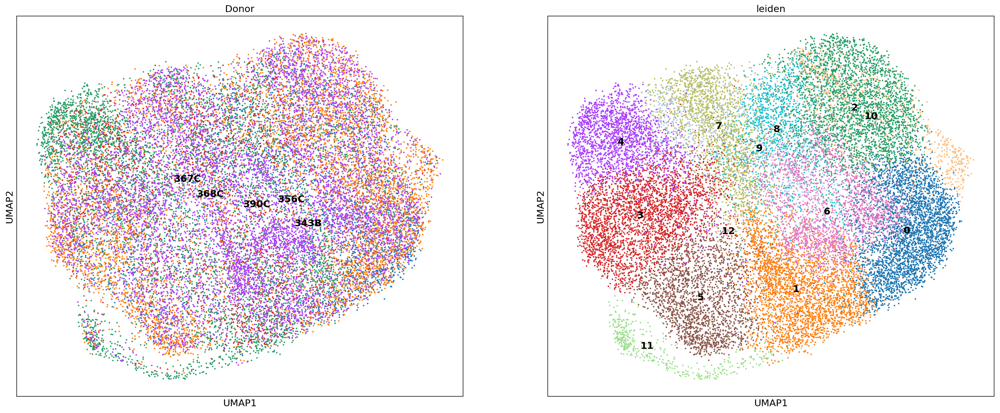

In [298]:
sc.pl.umap(tiss,color=['Donor','leiden'], legend_loc='on data', size=20)

In [402]:
marker_genes_lympho = ['CD3E','CD4', 'CD8A', #T-cells CD4, CD8, NK
                        'GZMB', 'GNLY', 'PRF1', #Cytotoxic T CTL
    'FOXP3', 'IL2RA', #Treg
                    'NCR1', 'NCAM1', 'CD160' #NK
                     ]

In [72]:
#sc.pl.umap(tiss,color=marker_genes_lympho, size=20)

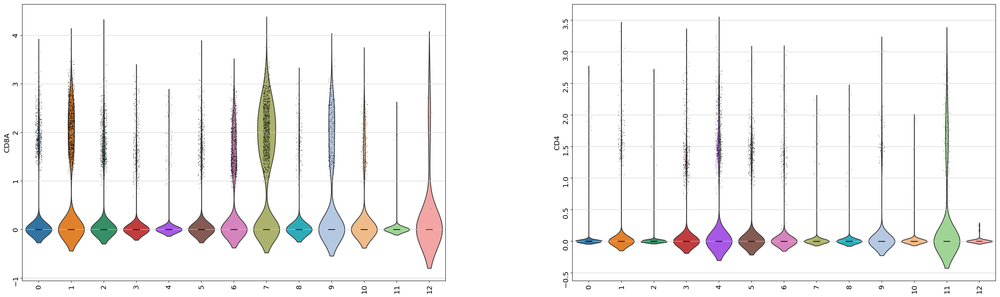

In [302]:
sc.pl.violin(tiss, ['CD8A', 'CD4'], groupby='leiden', rotation=90)

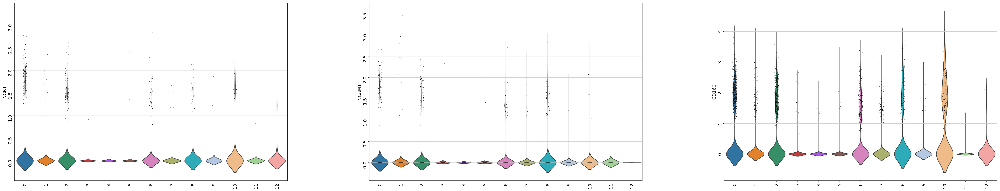

In [303]:
sc.pl.violin(tiss, ['NCR1', 'NCAM1', 'CD160'], groupby='leiden', rotation=90)

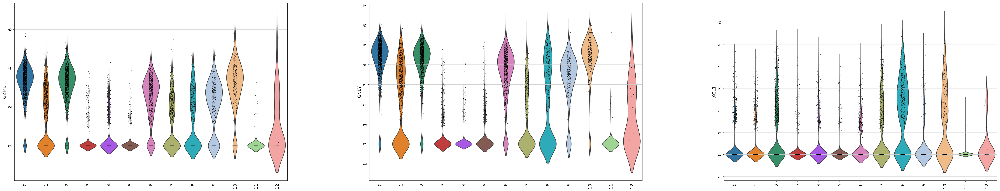

In [310]:
sc.pl.violin(tiss, ['GZMB', 'GNLY'], groupby='leiden', rotation=90) #cytotoxic

In [423]:
new_cluster_names = [
    'NK', 'T_CD8_CytT', #0,1
    'NK', 'T_CD4', #2, 3
    'T_CD4', 'T_CD4',#4, 5
    'NK', 'T_CD8_CytT', #6, 7
    'NK', 'T_CD8_CytT', #8,9
    'NK', 'T_regulatory', #10, 11
    'T_CD8_CytT',#12
]


In [424]:
conv = {str(i):name for i,name in enumerate(new_cluster_names)}

In [425]:
tiss.obs['anno_1'] = [conv[x] for x in tiss.obs['leiden']]

In [314]:
cdm_out = calculate_markers(tiss,'leiden')

0
1
10
11
12
2
3
4
5
6
7
8
9


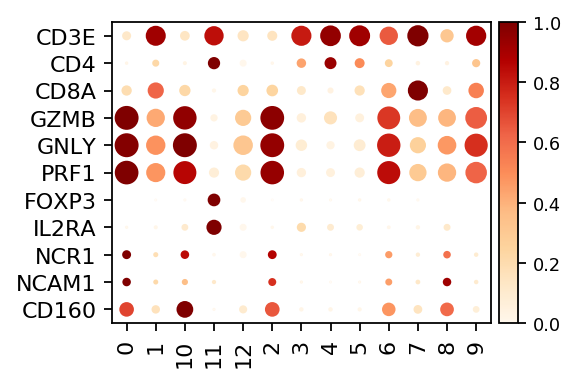

In [406]:
draw_marker_blob(tiss, cdm_out, marker_genes_lympho, min_drop_ratio=0)

... storing 'anno_1' as categorical


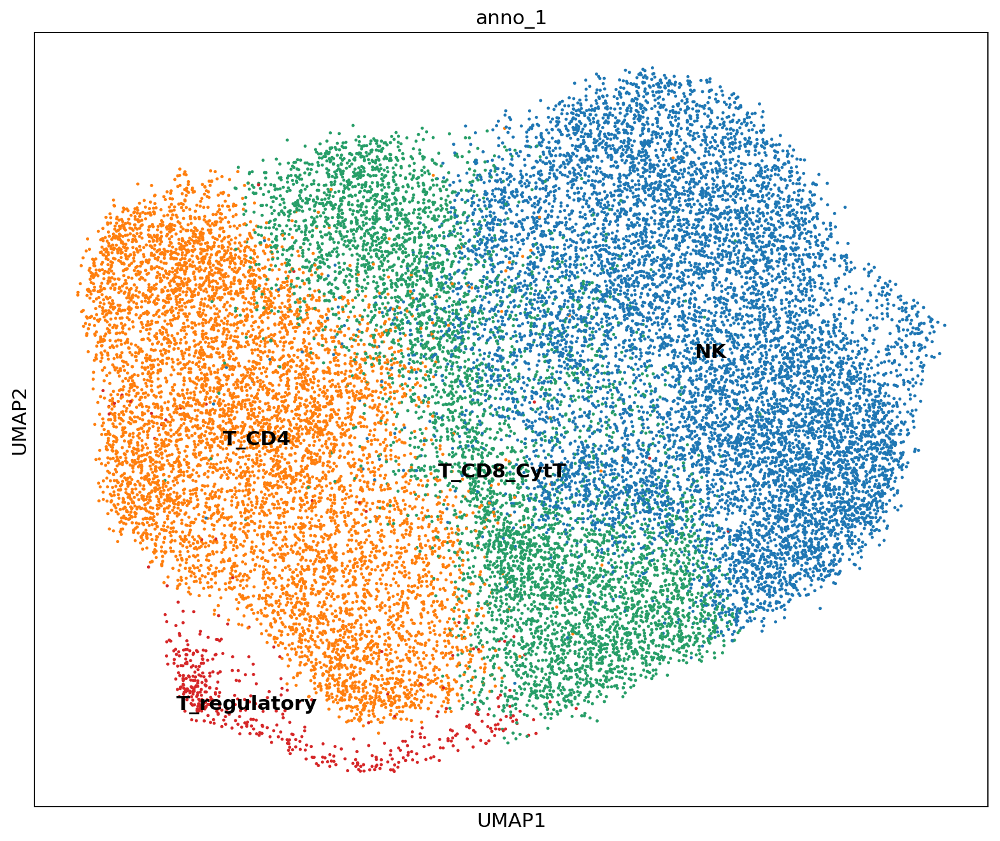

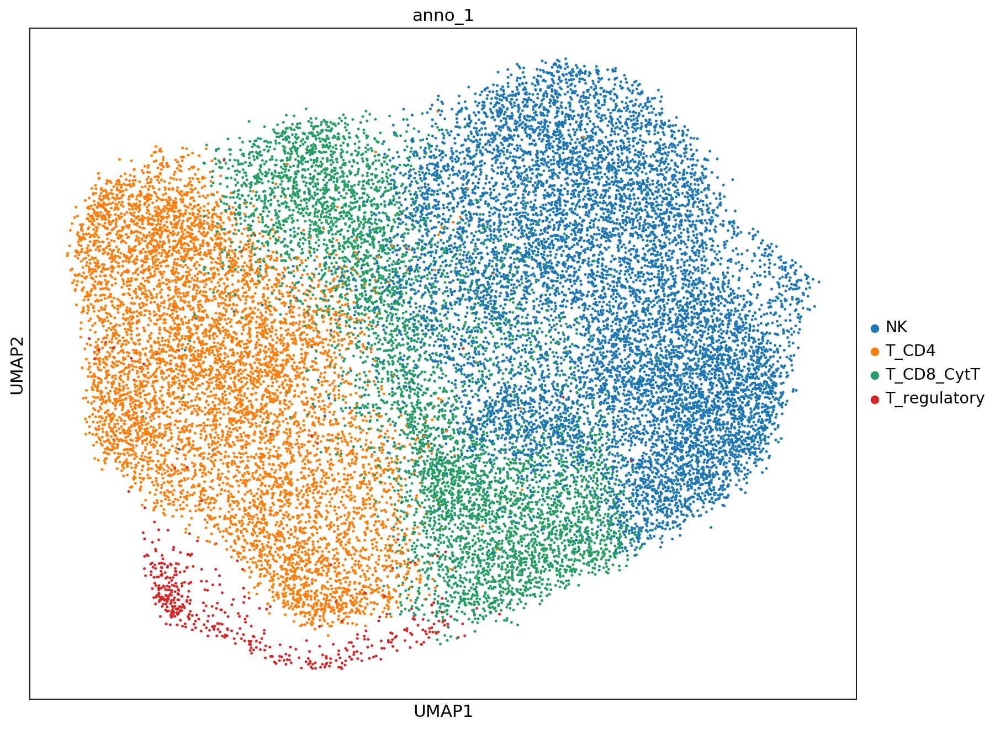

In [426]:
sc.pl.umap(tiss,color=['anno_1'], legend_loc='on data',
           size=20)
sc.pl.umap(tiss,color=['anno_1'], 
           size=20)



In [427]:
tiss.write('lung_lympho.h5ad')

## Combine identities

In [49]:
#adata = sc.read('lung.h5ad')
imm = sc.read('lung_imm.h5ad')
lympho=sc.read('lung_lympho.h5ad')
div= sc.read('lung_div.h5ad')

In [50]:
adata.obs['cell_types'] = adata.obs['Celltype']

In [51]:
update_label(imm,'anno_1',adata,'cell_types','cell_types_updated')

In [52]:
update_label(lympho,'anno_1',adata,'cell_types_updated','cell_types_updated2')

In [53]:
update_label(div,'anno_1',adata,'cell_types_updated2','cell_types_updated3')

In [54]:
adata.obs['Celltypes'] = adata.obs['cell_types_updated3']

In [73]:
pylab.rcParams['figure.figsize'] = (12, 10)
#sc.pl.umap(adata,color=['Celltypes'], #legend_loc='on data', 
#           size=5)

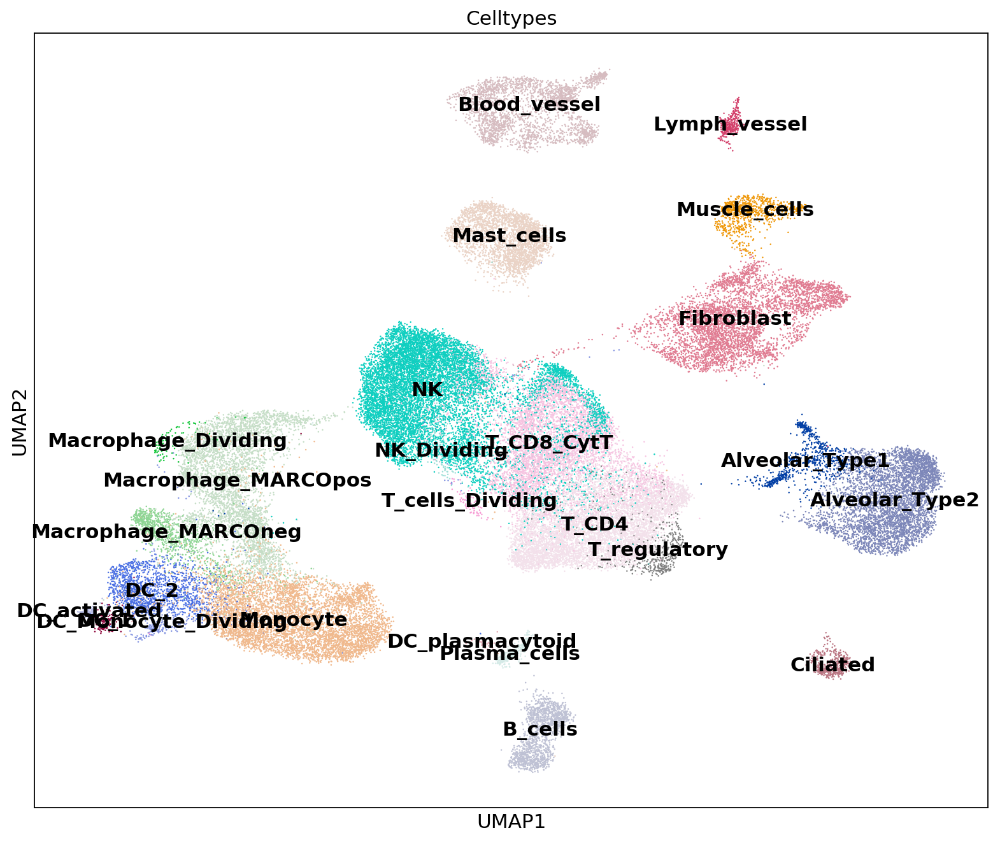

In [56]:
sc.pl.umap(adata,color=['Celltypes'], #legend_loc='on data', 
           size=5, legend_loc='on data')

In [57]:
cdm_out = calculate_markers(adata,'Celltypes')

Alveolar_Type1
Alveolar_Type2
B_cells
Blood_vessel
Ciliated
DC_1
DC_2
DC_Monocyte_Dividing
DC_activated
DC_plasmacytoid
Fibroblast
Lymph_vessel
Macrophage_Dividing
Macrophage_MARCOneg
Macrophage_MARCOpos
Mast_cells
Monocyte
Muscle_cells
NK
NK_Dividing
Plasma_cells
T_CD4
T_CD8_CytT
T_cells_Dividing
T_regulatory


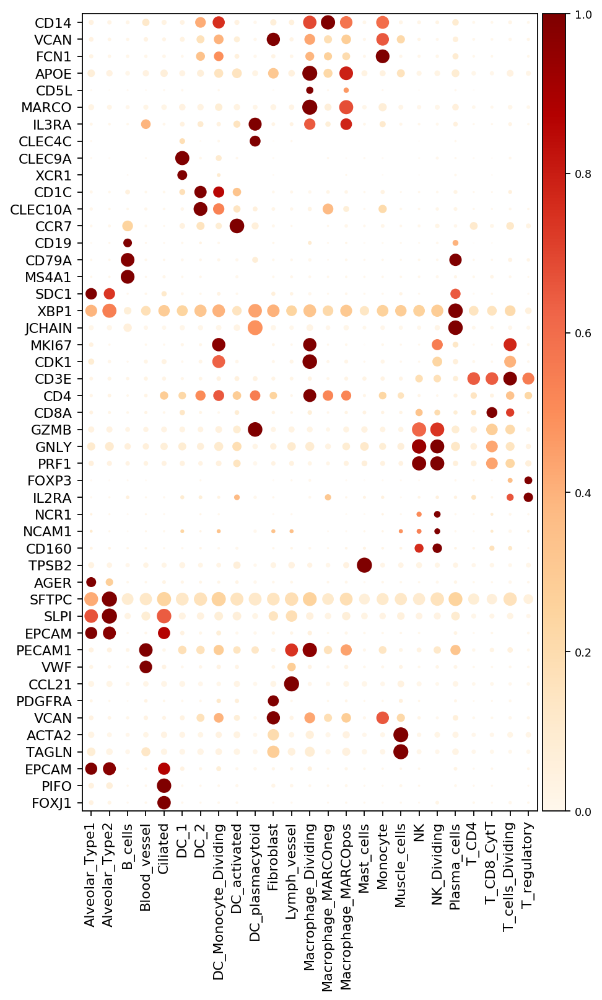

In [58]:
marker_genes_all = ['CD14', 'VCAN', 'FCN1', #Monocyte
                  'APOE', 'CD5L', #Macrophage
                       'MARCO', #Macrophage type 1 and 2 (type 2 is CD1C- and MARCO-)
                  'IL3RA', 'CLEC4C', #plasmacytoid DC
                'CLEC9A', 'XCR1', #cDC1
                  'CD1C',  'CLEC10A', #cDC2
                    'CCR7', #Activated DC
                
                  'CD19', 'CD79A', 'MS4A1', #B-cell
                  'SDC1', 'XBP1', 'JCHAIN', #Plasma cells
                
                  'MKI67','CDK1', #Dividing
                
                  'CD3E','CD4', 'CD8A', #T-cells CD4 or CD8
                        'GZMB', 'GNLY', 'PRF1',#Cytotoxic T CTL
                    'FOXP3', 'IL2RA', #Treg
                  'NCR1', 'NCAM1', 'CD160', #NK
                       'TPSB2', #Mast cells
                       'AGER', 'SFTPC', 'SLPI','EPCAM', #Type 1 (AGER) and 2 alveolar cells
                       'PECAM1', #Epithelial layer of vessels
                       'VWF', 'CCL21', #vascular vs lymphatic
                       'PDGFRA', 'VCAN', #Fibroblast
                       'ACTA2', 'TAGLN', #Muscle cells
                       'EPCAM','PIFO', 'FOXJ1' #ciliated
                      ]

draw_marker_blob(adata, cdm_out, marker_genes_all, min_drop_ratio=0)

In [544]:
adata.write('lung_annot.h5ad')

In [74]:
#sc.pl.violin(adata, ['n_genes'],
#            jitter=0.4, groupby='Celltypes', rotation=90)
#sc.pl.violin(adata, ['n_counts'],
#            jitter=0.4, groupby='Celltypes', rotation=90)
#sc.pl.violin(adata, ['percent_mito'],
#            jitter=0.4, groupby='Celltypes', rotation=90)

In [561]:
adata.obs.to_csv("lung_meta.csv")